# Bar Chart Race of Spider Species Description - From 1889 to 2021

Data was obtained from the World Spider Catalog: https://wsc.nmbe.ch/

The species were grouped by family and ploted in to a bar chart race.

In [1]:
#!pip install bar_chart_race

Ver: https://towardsdatascience.com/animations-with-matplotlib-d96375c5442c

Ver: https://plotly.com/python/animations/

https://towardsdatascience.com/bar-chart-race-in-python-with-matplotlib-8e687a5c8a41

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import bar_chart_race as bcr
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML

In [3]:
spider = pd.read_csv('species_export_20210501.csv')
spider

,speciesId,species_lsid,family,genus,species,subspecies,author,year,parentheses,distribution
0,1,urn:lsid:nmbe.ch:spidersp:000896,Actinopodidae,Actinopus,caraiba,NaN,Simon,1889,1,Venezuela
1,2,urn:lsid:nmbe.ch:spidersp:000898,Actinopodidae,Actinopus,crassipes,NaN,Keyserling,1891,1,"Brazil, Paraguay, Argentina"
2,3,urn:lsid:nmbe.ch:spidersp:000899,Actinopodidae,Actinopus,cucutaensis,NaN,Mello-Leitão,1941,0,"Colombia, Venezuela, Brazil"
3,4,urn:lsid:nmbe.ch:spidersp:000900,Actinopodidae,Actinopus,dubiomaculatus,NaN,Mello-Leitão,1923,0,Brazil
4,5,urn:lsid:nmbe.ch:spidersp:000901,Actinopodidae,Actinopus,echinus,NaN,Mello-Leitão,1949,0,Brazil
...,...,...,...,...,...,...,...,...,...,...
49431,59336,urn:lsid:nmbe.ch:spidersp:053151,Cybaeidae,Cybaeus,ubicki,NaN,Bennett,2021,0,USA
49432,59337,urn:lsid:nmbe.ch:spidersp:053152,Oonopidae,Trilacuna,jinyun,NaN,"Tong, Zhang & Li",2021,0,China
49433,59338,urn:lsid:nmbe.ch:spidersp:053153,Oonopidae,Trilacuna,jiuchi,NaN,"Tong, Zhang & Li",2021,0,China
49434,59339,urn:lsid:nmbe.ch:spidersp:053154,Clubionidae,Clubiona,jiugong,NaN,Yu & Zhong,2021,0,China


In [4]:
spider.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49436 entries, 0 to 49435
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   speciesId     49436 non-null  int64 
 1   species_lsid  49436 non-null  object
 2   family        49436 non-null  object
 3   genus         49436 non-null  object
 4   species       49436 non-null  object
 5   subspecies    485 non-null    object
 6   author        49436 non-null  object
 7   year          49436 non-null  int64 
 8   parentheses   49436 non-null  int64 
 9   distribution  49435 non-null  object
dtypes: int64(3), object(7)
memory usage: 3.8+ MB


In [5]:
spider.shape

(49436, 10)

In [6]:
spider.isnull().sum()

speciesId           0
species_lsid        0
family              0
genus               0
species             0
subspecies      48951
author              0
year                0
parentheses         0
distribution        1
dtype: int64

In [7]:
spider.drop(['subspecies','genus','species','species_lsid','parentheses','author','distribution'],axis='columns', inplace=True)
spider

,speciesId,family,year
0,1,Actinopodidae,1889
1,2,Actinopodidae,1891
2,3,Actinopodidae,1941
3,4,Actinopodidae,1923
4,5,Actinopodidae,1949
...,...,...,...
49431,59336,Cybaeidae,2021
49432,59337,Oonopidae,2021
49433,59338,Oonopidae,2021
49434,59339,Clubionidae,2021


In [8]:
spider.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49436 entries, 0 to 49435
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   speciesId  49436 non-null  int64 
 1   family     49436 non-null  object
 2   year       49436 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 1.1+ MB


In [9]:
spider['family'].value_counts()

Salticidae           6343
Linyphiidae          4695
Araneidae            3065
Gnaphosidae          2559
Theridiidae          2522
                     ... 
Mecicobothriidae        2
Megahexuridae           1
Myrmecicultoridae       1
Trogloraptoridae        1
Huttoniidae             1
Name: family, Length: 129, dtype: int64

In [10]:
spider["total"] = spider.groupby(["family", "year"])["speciesId"].transform('count')
spider

,speciesId,family,year,total
0,1,Actinopodidae,1889,4
1,2,Actinopodidae,1891,1
2,3,Actinopodidae,1941,1
3,4,Actinopodidae,1923,1
4,5,Actinopodidae,1949,1
...,...,...,...,...
49431,59336,Cybaeidae,2021,17
49432,59337,Oonopidae,2021,11
49433,59338,Oonopidae,2021,11
49434,59339,Clubionidae,2021,15


In [11]:
spider.drop(['speciesId'],axis='columns', inplace=True)
spider

,family,year,total
0,Actinopodidae,1889,4
1,Actinopodidae,1891,1
2,Actinopodidae,1941,1
3,Actinopodidae,1923,1
4,Actinopodidae,1949,1
...,...,...,...
49431,Cybaeidae,2021,17
49432,Oonopidae,2021,11
49433,Oonopidae,2021,11
49434,Clubionidae,2021,15


In [12]:
spider.drop_duplicates(keep = 'first', inplace = True)
spider

,family,year,total
0,Actinopodidae,1889,4
1,Actinopodidae,1891,1
2,Actinopodidae,1941,1
3,Actinopodidae,1923,1
4,Actinopodidae,1949,1
...,...,...,...
49378,Araneidae,2021,8
49386,Entypesidae,2021,2
49413,Eresidae,2021,1
49415,Nemesiidae,2021,1


https://stackoverflow.com/questions/22650833/pandas-groupby-cumulative-sum

### Including missing years

In [13]:
spider_families = spider['family'].unique()

In [14]:
spider_families

array(['Actinopodidae', 'Agelenidae', 'Stiphidiidae', 'Cycloctenidae',
       'Amaurobiidae', 'Titanoecidae', 'Desidae', 'Zoropsidae',
       'Toxopidae', 'Ammoxenidae', 'Anapidae', 'Antrodiaetidae',
       'Anyphaenidae', 'Araneidae', 'Theridiidae', 'Arkyidae',
       'Linyphiidae', 'Archaeidae', 'Atypidae', 'Austrochilidae',
       'Barychelidae', 'Theraphosidae', 'Pycnothelidae', 'Caponiidae',
       'Cithaeronidae', 'Clubionidae', 'Cheiracanthiidae',
       'Phrurolithidae', 'Corinnidae', 'Trachelidae', 'Liocranidae',
       'Miturgidae', 'Ctenidae', 'Trechaleidae', 'Xenoctenidae',
       'Viridasiidae', 'Halonoproctidae', 'Ctenizidae', 'Stasimopidae',
       'Cyatholipidae', 'Dictynidae', 'Cybaeidae', 'Cyrtaucheniidae',
       'Microstigmatidae', 'Nemesiidae', 'Bemmeridae', 'Deinopidae',
       'Hahniidae', 'Diguetidae', 'Euagridae', 'Ischnothelidae',
       'Dipluridae', 'Microhexuridae', 'Anamidae', 'Drymusidae',
       'Dysderidae', 'Eresidae', 'Euctenizidae', 'Filistatidae',
 

In [15]:
spider_year = spider['year'].unique()

In [16]:
spider_year.sort()
print(spider_year)

[1757 1758 1761 1763 1767 1768 1770 1772 1775 1776 1777 1778 1781 1782
 1785 1787 1788 1789 1790 1793 1797 1798 1799 1801 1802 1803 1804 1805
 1806 1809 1811 1817 1818 1819 1820 1821 1822 1823 1824 1825 1826 1827
 1829 1830 1831 1832 1833 1834 1835 1836 1837 1838 1839 1840 1841 1842
 1843 1844 1845 1846 1847 1849 1850 1851 1852 1853 1854 1855 1856 1857
 1858 1859 1861 1862 1863 1864 1865 1866 1867 1868 1869 1870 1871 1872
 1873 1874 1875 1876 1877 1878 1879 1880 1881 1882 1883 1884 1885 1886
 1887 1888 1889 1890 1891 1892 1893 1894 1895 1896 1897 1898 1899 1900
 1901 1902 1903 1904 1905 1906 1907 1908 1909 1910 1911 1912 1913 1914
 1915 1916 1917 1918 1919 1920 1921 1922 1923 1924 1925 1926 1927 1928
 1929 1930 1931 1932 1933 1934 1935 1936 1937 1938 1939 1940 1941 1942
 1943 1944 1945 1946 1947 1948 1949 1950 1951 1952 1953 1954 1955 1956
 1957 1958 1959 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970
 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984
 1985 

In [17]:
#create a new dataframe with all the families
columns = ["family"]
data = np.array(spider_families)
spider_new = pd.DataFrame(data=data, columns=columns)

In [18]:
spider_new

,family
0,Actinopodidae
1,Agelenidae
2,Stiphidiidae
3,Cycloctenidae
4,Amaurobiidae
...,...
124,Pacullidae
125,Theridiosomatidae
126,Trogloraptoridae
127,Uloboridae


In [19]:
#create a range
dates = [1757, 1758, 1759, 1760, 1761, 1762, 1763, 1764, 1765, 1766, 1767, 1768, 1769, 1770, 
         1771, 1772, 1773, 1774, 1775, 1776, 1777, 1778, 1779, 1780, 1781, 1782, 1783, 1784, 1785, 1786, 1787, 1788, 1789, 1790,
         1791, 1792, 1793, 1794, 1795, 1796, 1797, 1798, 1799, 1800, 1801, 1802, 1803, 1804, 1805, 1806, 1807, 1808, 1809, 1810, 
         1811, 1812, 1813, 1814, 1815, 1816, 1817, 1818, 1819, 1820, 1821, 1822, 1823, 1824, 1825, 1826, 1827, 1828, 1829, 1830, 
         1831, 1832, 1833, 1834, 1835, 1836, 1837, 1838, 1839, 1840, 1841, 1842, 1843, 1844, 1845, 1846, 1847, 1848, 1849, 1850,
         1851, 1852, 1853, 1854, 1855, 1856, 1857, 1858, 1859, 1860, 1861, 1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1870,
         1871, 1872, 1873, 1874, 1875, 1876, 1877, 1878, 1879, 1880, 1881, 1882, 1883, 1884, 1885, 1886, 1887, 1888, 1889, 1890,
         1891, 1892, 1893, 1894, 1895, 1896, 1897, 1898, 1899, 1900, 1901, 1902, 1903, 1904, 1905, 1906, 1907, 1908, 1909, 1910,
         1911, 1912, 1913, 1914, 1915, 1916, 1917, 1918, 1919, 1920, 1921, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930,
         1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950,
         1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970,
         1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990,
         1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010,
         2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]
 
dates_series = pd.Series(dates)

In [20]:
result = pd.DataFrame()

for i in range(len(spider_new)):
    df_temp_multiple = pd.DataFrame()

    df_temp_single = spider_new.iloc[i]

    df_temp_multiple = df_temp_multiple.append([df_temp_single]*len(dates_series), ignore_index=True)
    df_temp_multiple = pd.concat([df_temp_multiple, dates_series], axis=1)

    result = pd.concat([result, df_temp_multiple], ignore_index=True) 

In [21]:
result

,family,0
0,Actinopodidae,1757
1,Actinopodidae,1758
2,Actinopodidae,1759
3,Actinopodidae,1760
4,Actinopodidae,1761
...,...,...
34180,Myrmecicultoridae,2017
34181,Myrmecicultoridae,2018
34182,Myrmecicultoridae,2019
34183,Myrmecicultoridae,2020


In [22]:
result.columns =['family', 'year']
result

,family,year
0,Actinopodidae,1757
1,Actinopodidae,1758
2,Actinopodidae,1759
3,Actinopodidae,1760
4,Actinopodidae,1761
...,...,...
34180,Myrmecicultoridae,2017
34181,Myrmecicultoridae,2018
34182,Myrmecicultoridae,2019
34183,Myrmecicultoridae,2020


In [23]:
result['total'] = 0
result

,family,year,total
0,Actinopodidae,1757,0
1,Actinopodidae,1758,0
2,Actinopodidae,1759,0
3,Actinopodidae,1760,0
4,Actinopodidae,1761,0
...,...,...,...
34180,Myrmecicultoridae,2017,0
34181,Myrmecicultoridae,2018,0
34182,Myrmecicultoridae,2019,0
34183,Myrmecicultoridae,2020,0


## Join the dataframes

In [24]:
spider_new = pd.merge(spider, result, how = 'outer') 
spider_new

,family,year,total
0,Actinopodidae,1889,4
1,Actinopodidae,1891,1
2,Actinopodidae,1941,1
3,Actinopodidae,1923,1
4,Actinopodidae,1949,1
...,...,...,...
40648,Myrmecicultoridae,2017,0
40649,Myrmecicultoridae,2018,0
40650,Myrmecicultoridae,2019,0
40651,Myrmecicultoridae,2020,0


## Cummulative sum of all species per family per year

In [25]:
#spider.groupby(['family', 'year']).sum().groupby(level=0).cumsum().reset_index()

In [26]:
# soma acumulativa das espécies por família e por ano
spider1 = pd.DataFrame(spider_new.groupby(['family', 'year']).sum().groupby(level=0).cumsum().reset_index())
spider1

,family,year,total
0,Actinopodidae,1757,0
1,Actinopodidae,1758,0
2,Actinopodidae,1759,0
3,Actinopodidae,1760,0
4,Actinopodidae,1761,0
...,...,...,...
34180,Zoropsidae,2017,180
34181,Zoropsidae,2018,182
34182,Zoropsidae,2019,182
34183,Zoropsidae,2020,183


## Preparing the Bar Chart Race

In [27]:
#spider1 = pd.DataFrame(spider.groupby(['family', 'year']).sum().groupby(level=0).cumsum().reset_index())

In [28]:
current_year = 1778
spider2 = (spider1[spider1['year'].eq(current_year)].sort_values(by='total', ascending=False).head(20))
print(spider2)

               family  year  total
2141        Araneidae  1778     30
15391       Lycosidae  1778     19
25726      Salticidae  1778     11
30231     Theridiidae  1778      9
30761      Thomisidae  1778      6
14596     Linyphiidae  1778      5
22546   Philodromidae  1778      4
29701  Tetragnathidae  1778      3
24136      Pisauridae  1778      3
7971       Dictynidae  1778      3
22811       Pholcidae  1778      2
27316     Sparassidae  1778      2
286        Agelenidae  1778      2
10886     Gnaphosidae  1778      2
29966   Theraphosidae  1778      1
5321      Clubionidae  1778      1
551      Amaurobiidae  1778      1
19366      Nesticidae  1778      1
9031       Dysderidae  1778      1
9561         Eresidae  1778      1


<BarContainer object of 20 artists>

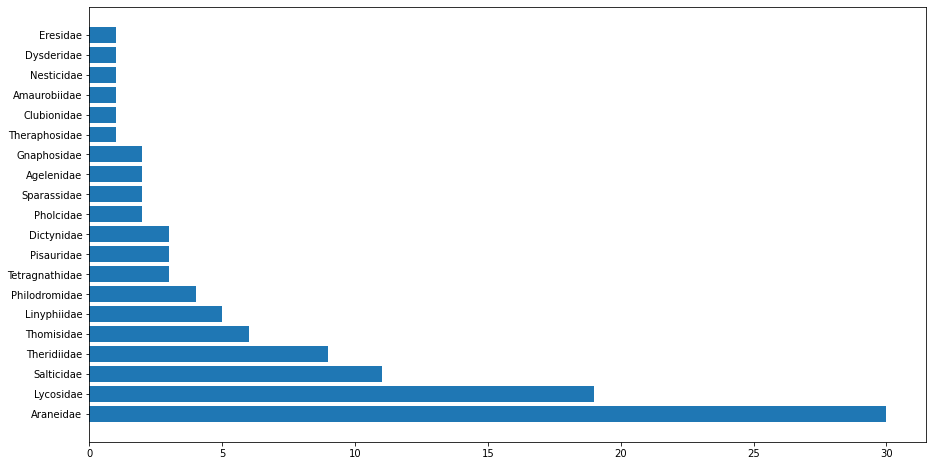

In [29]:
fig, ax = plt.subplots(figsize=(15, 8))
ax.barh(spider2['family'], spider2['total'])

Text(1, 0.4, '1778')

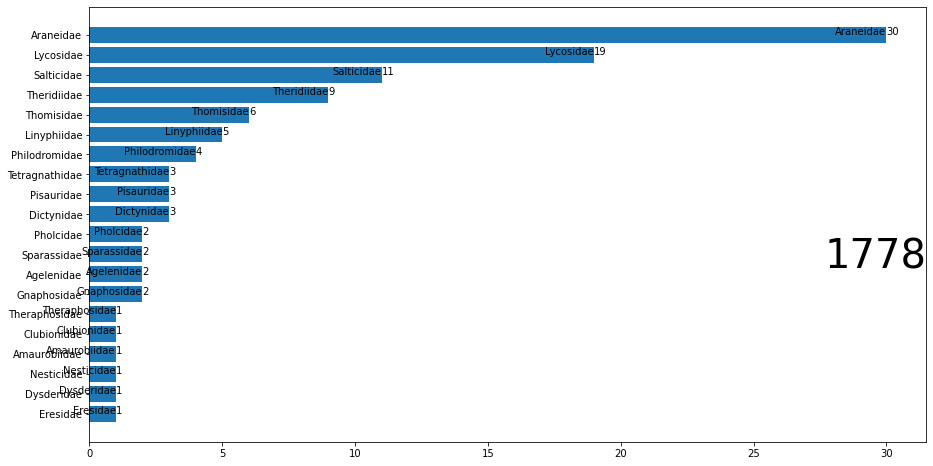

In [58]:
fig, ax = plt.subplots(figsize=(15, 8))
spider2 = spider2[::-1]   # flip values from top to bottom


ax.barh(spider2['family'], spider2['total'])

# iterate over the values to plot labels and values
for i, (value, name) in enumerate(zip(spider2['total'], spider2['family'])):
    ax.text(value, i, name, ha='right')  
    ax.text(value, i, value, ha='left')   
# Add year right middle portion of canvas
ax.text(1, 0.4, current_year, transform=ax.transAxes, size=40, ha='right')


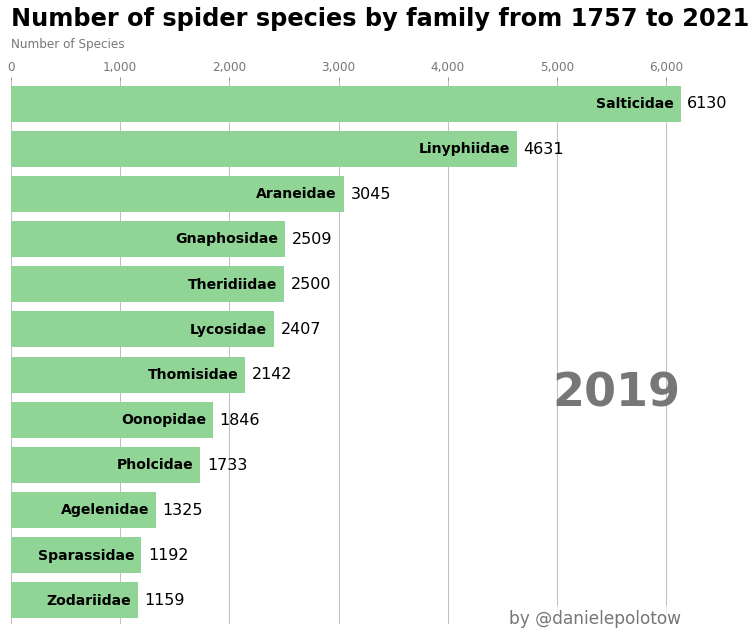

In [50]:
fig, ax = plt.subplots(figsize=(12, 10))

def draw_barchart(year):
    spider2 = spider1[spider1['year'].eq(year)].sort_values(by='total', ascending=True).tail(12)
    ax.clear() 
    ax.barh(spider2['family'], spider2['total'], color="#90d595") 
    dx = spider2['total'].max()/100
    
    for i, (value, name) in enumerate(zip(spider2['total'], spider2['family'])):
        ax.text(value-dx, i, name, size=14, weight=600, ha='right', va='center')  
        ax.text(value+dx, i, value, size=16, ha='left', va='center')
        
    # ... polished styles
    
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(0, 1.06, 'Number of Species', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.10, 'Number of spider species by family from 1757 to 2021',transform=ax.transAxes, size=24, weight=600, ha='left')
    ax.text(1, 0, 'by @danielepolotow', transform=ax.transAxes, ha='right',color='#777777', size=17, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
    plt.box(False)
    
draw_barchart(2019)

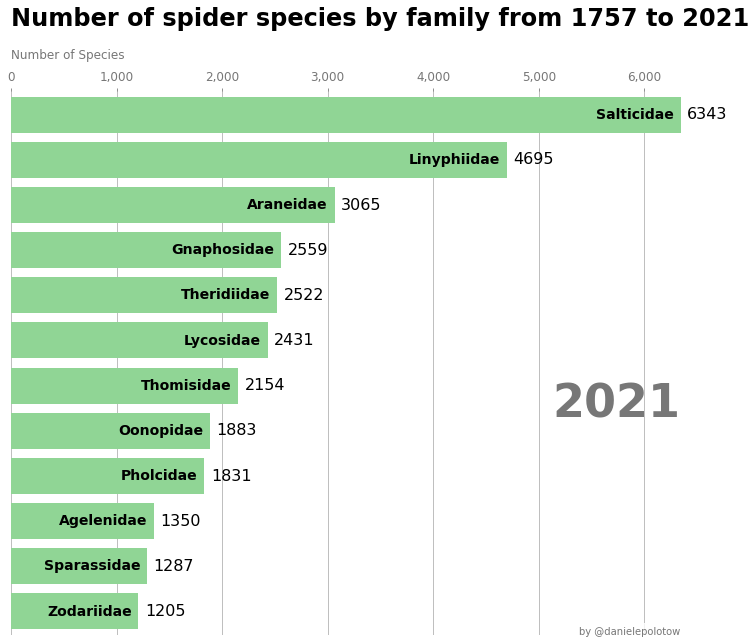

In [32]:
#não modificar!
import matplotlib.animation as animation
from IPython.display import HTML
fig, ax = plt.subplots(figsize=(12, 10))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(1757, 2022), interval=180)
HTML(animator.to_jshtml()) 
# or use animator.to_html5_video() or animator.save()

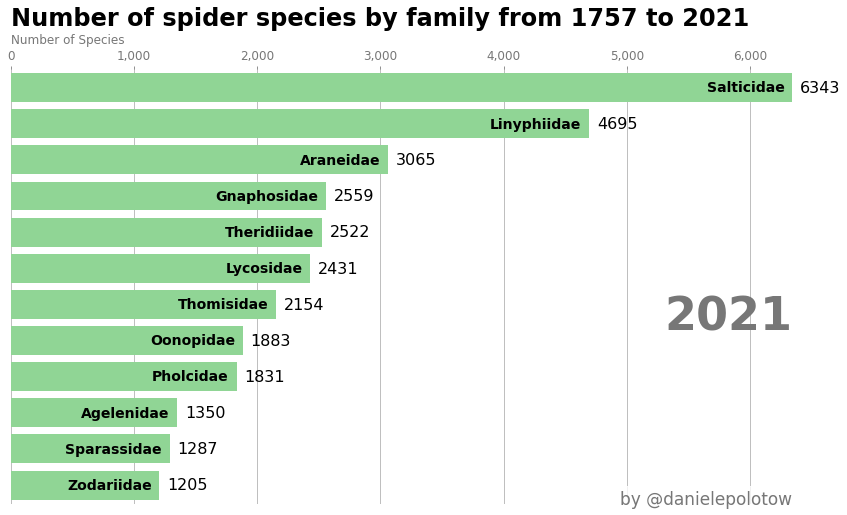

In [56]:
# FUNCIONANDO!!!

import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.animation import FFMpegWriter

fig, ax = plt.subplots(figsize=(14, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(1757, 2022), interval=160)

#HTML( animator.to_html5_video()) 

#animator.save('basic_animation.mp4', fps=30)

# FFMpegWriter(animator.save("catt.gif")) 
# or use animator.to_html5_video() or animator.save() animator.to_jshtml()


html = animator.to_html5_video()
HTML(html)
#anim.save('media/spiderr.mp4')

In [ ]:
#!pip install ffmpeg

In [ ]:
plt.savefig("dbscan_dumb.png", dpi=300)

TypeError: to_html5_video() got an unexpected keyword argument 'bitrate'

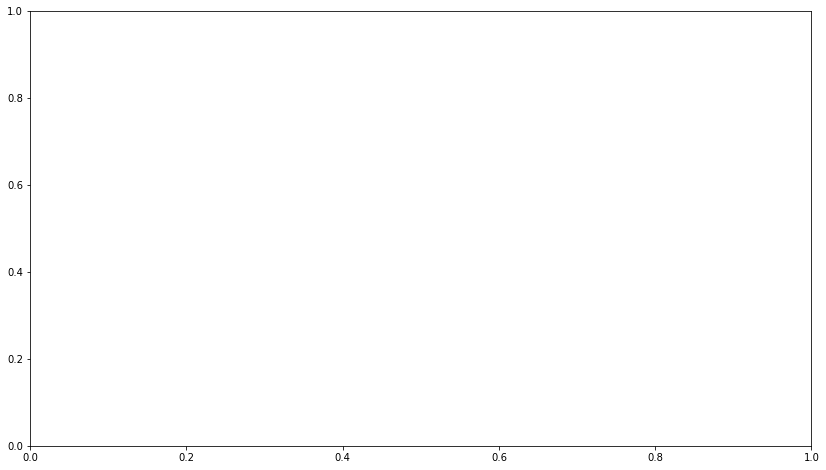

In [55]:
import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.animation import FFMpegWriter

fig, ax = plt.subplots(figsize=(14, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(1757, 2022), interval=180)

#HTML( animator.to_html5_video()) 

#animator.save('basic_animation.mp4', fps=30)

# FFMpegWriter(animator.save("catt.gif")) 
# or use animator.to_html5_video() or animator.save() animator.to_jshtml()


html = animator.to_html5_video()
HTML(html)
#anim.save('media/spiderr.mp4')